In [2]:
%run ./resources/library.py

In [3]:
style_notebook()

# Exploring TB and Socio-economic Indicators

## Goals

Our goal for this TB exploration notebook is to construct a "gapminder" for TB data and a time series choropleth map. See figures below.

![Gapminder for TB](images/gapminder-for-tb.png)

**Figure 1**. Interactive Gapminder bubble chart for TB data

![Choropleth Timeseries for TB](images/choropleth-timeseries-tb.png)

**Figure 2**. Interactive choropleth map for TB data

## Steps in this notebook

1. Set up data exploration environment
2. Download and clean up data from the WHO, World Bank
3. Merge, clean, explore dataframes
4. Generate plotly express visualizations

## STEP 1. Set up data exploration environment

To create visualizations, we will use Plotly Express. You can learn more about Plotly Express from:
1. [Plotly GitHub Site](https://github.com/plotly/plotly_express) (GitHub)
2. [Jupyter Notebook Example](https://www.plotly.express/)
3. Some articles written about it [here](https://medium.com/@plotlygraphs/introducing-plotly-express-808df010143d) and [here](https://towardsdatascience.com/plotly-express-the-good-the-bad-and-the-ugly-dc941649687c)

In [4]:
import plotly_express as px
px.__version__

'0.2.2'

We will also use our Swiss Army knife for data science, `pandas`.

In [5]:
import pandas as pd
pd.__version__

'0.24.2'

In [6]:
pd.set_option('max_colwidth', 150)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

**`missingno`**: Missing data visualization module for Python 

Read more about it here: https://github.com/ResidentMario/missingno

In [62]:
import missingno as mno
mno.__version__

'0.4.1'

In [66]:
%matplotlib inline

## STEP 2. Download and clean up data

All data files are found in the `resources` folder.

### 1. World Health Organization (WHO), estimates of TB burden

Data from 2000-2017 provided by countries to WHO and estimates of TB burden generated by WHO for the Global Tuberculosis Report. 

1. Source, data: https://extranet.who.int/tme/generateCSV.asp?ds=estimates
2. Source, metadata: https://extranet.who.int/tme/generateCSV.asp?ds=dictionary
3. Instructions: No need to modify CSV download.

**Aggregate Data**

In [7]:
tb_df1 = pd.read_csv("resources/TB_burden_countries_2019-07-03.csv")

tb_df1.head()

,country,iso2,iso3,iso_numeric,g_whoregion,year,e_pop_num,e_inc_100k,e_inc_100k_lo,e_inc_100k_hi,e_inc_num,e_inc_num_lo,e_inc_num_hi,e_tbhiv_prct,e_tbhiv_prct_lo,e_tbhiv_prct_hi,e_inc_tbhiv_100k,e_inc_tbhiv_100k_lo,e_inc_tbhiv_100k_hi,e_inc_tbhiv_num,e_inc_tbhiv_num_lo,e_inc_tbhiv_num_hi,e_mort_exc_tbhiv_100k,e_mort_exc_tbhiv_100k_lo,e_mort_exc_tbhiv_100k_hi,e_mort_exc_tbhiv_num,e_mort_exc_tbhiv_num_lo,e_mort_exc_tbhiv_num_hi,e_mort_tbhiv_100k,e_mort_tbhiv_100k_lo,e_mort_tbhiv_100k_hi,e_mort_tbhiv_num,e_mort_tbhiv_num_lo,e_mort_tbhiv_num_hi,e_mort_100k,e_mort_100k_lo,e_mort_100k_hi,e_mort_num,e_mort_num_lo,e_mort_num_hi,cfr,cfr_lo,cfr_hi,c_newinc_100k,c_cdr,c_cdr_lo,c_cdr_hi
0,Afghanistan,AF,AFG,4,EMR,2000,20093756,190.0,123.0,271.0,38000,25000,54000,0.36,0.12,0.72,0.68,0.20,1.50,140.0,40.0,290.0,67.0,39.0,103.0,14000,7800.0,21000.0,0.15,0.00,0.77,31,0,160,67.0,39.0,104.0,14000,7800,21000,NaN,NaN,NaN,35.0,19.0,13.0,29.0
1,Afghanistan,AF,AFG,4,EMR,2001,20966463,189.0,123.0,271.0,40000,26000,57000,0.30,0.10,0.61,0.57,0.16,1.20,120.0,34.0,260.0,62.0,36.0,95.0,13000,7500.0,20000.0,0.17,0.00,0.62,35,1,130,62.0,36.0,95.0,13000,7500,20000,NaN,NaN,NaN,48.0,26.0,18.0,39.0
2,Afghanistan,AF,AFG,4,EMR,2002,21979923,189.0,122.0,270.0,42000,27000,59000,0.26,0.09,0.52,0.49,0.15,1.00,110.0,32.0,230.0,56.0,33.0,86.0,12000,7200.0,19000.0,0.27,0.08,0.58,60,17,130,56.0,33.0,86.0,12000,7200,19000,NaN,NaN,NaN,63.0,33.0,23.0,51.0
3,Afghanistan,AF,AFG,4,EMR,2003,23064851,189.0,122.0,270.0,44000,28000,62000,0.23,0.09,0.45,0.44,0.14,0.92,100.0,31.0,210.0,57.0,33.0,87.0,13000,7700.0,20000.0,0.25,0.07,0.52,57,17,120,57.0,33.0,88.0,13000,7700,20000,NaN,NaN,NaN,60.0,32.0,22.0,49.0
4,Afghanistan,AF,AFG,4,EMR,2004,24118979,189.0,122.0,270.0,46000,29000,65000,0.22,0.08,0.42,0.41,0.13,0.85,100.0,32.0,210.0,51.0,30.0,77.0,12000,7100.0,19000.0,0.21,0.07,0.43,50,16,100,51.0,30.0,77.0,12000,7200,19000,NaN,NaN,NaN,76.0,40.0,28.0,62.0


In [8]:
tb_df1.columns

Index(['country', 'iso2', 'iso3', 'iso_numeric', 'g_whoregion', 'year',
       'e_pop_num', 'e_inc_100k', 'e_inc_100k_lo', 'e_inc_100k_hi',
       'e_inc_num', 'e_inc_num_lo', 'e_inc_num_hi', 'e_tbhiv_prct',
       'e_tbhiv_prct_lo', 'e_tbhiv_prct_hi', 'e_inc_tbhiv_100k',
       'e_inc_tbhiv_100k_lo', 'e_inc_tbhiv_100k_hi', 'e_inc_tbhiv_num',
       'e_inc_tbhiv_num_lo', 'e_inc_tbhiv_num_hi', 'e_mort_exc_tbhiv_100k',
       'e_mort_exc_tbhiv_100k_lo', 'e_mort_exc_tbhiv_100k_hi',
       'e_mort_exc_tbhiv_num', 'e_mort_exc_tbhiv_num_lo',
       'e_mort_exc_tbhiv_num_hi', 'e_mort_tbhiv_100k', 'e_mort_tbhiv_100k_lo',
       'e_mort_tbhiv_100k_hi', 'e_mort_tbhiv_num', 'e_mort_tbhiv_num_lo',
       'e_mort_tbhiv_num_hi', 'e_mort_100k', 'e_mort_100k_lo',
       'e_mort_100k_hi', 'e_mort_num', 'e_mort_num_lo', 'e_mort_num_hi', 'cfr',
       'cfr_lo', 'cfr_hi', 'c_newinc_100k', 'c_cdr', 'c_cdr_lo', 'c_cdr_hi'],
      dtype='object')

**Data Dictionary**

You can look up the definitions of the columns above using the data dictionary dataframe.

In [9]:
tb_dict_df = pd.read_csv("resources/TB_data_dictionary_2019-07-03.csv")

tb_dict_df.head()

,variable_name,dataset,code_list,definition
0,budget_cpp_dstb,Budget,NaN,"Average cost of drugs budgeted per patient for drug-susceptible TB treatment, excluding buffer stock (US Dollars)"
1,budget_cpp_mdr,Budget,NaN,"Average cost of drugs budgeted per patient for MDR-TB treatment, excluding buffer stock (US Dollars)"
2,budget_cpp_xdr,Budget,NaN,"Average cost of drugs budgeted per patient for XDR-TB treatment, excluding buffer stock (US Dollars)"
3,budget_fld,Budget,NaN,Budget required for drugs to treat drug-susceptible TB (US Dollars)
4,budget_lab,Budget,NaN,"Budget required for laboratory infrastructure, equipment and supplies (US Dollars)"


In [10]:
tb_dict_df

,variable_name,dataset,code_list,definition
0,budget_cpp_dstb,Budget,NaN,"Average cost of drugs budgeted per patient for drug-susceptible TB treatment, excluding buffer stock (US Dollars)"
1,budget_cpp_mdr,Budget,NaN,"Average cost of drugs budgeted per patient for MDR-TB treatment, excluding buffer stock (US Dollars)"
2,budget_cpp_xdr,Budget,NaN,"Average cost of drugs budgeted per patient for XDR-TB treatment, excluding buffer stock (US Dollars)"
3,budget_fld,Budget,NaN,Budget required for drugs to treat drug-susceptible TB (US Dollars)
4,budget_lab,Budget,NaN,"Budget required for laboratory infrastructure, equipment and supplies (US Dollars)"
5,budget_mdrmgt,Budget,NaN,Budget required for programme costs to treat drug-resistant TB (US Dollars)
6,budget_orsrvy,Budget,NaN,Budget required for operational research and surveys (US Dollars)
7,budget_oth,Budget,NaN,Budget required for all other budget line items (US Dollars)
8,budget_patsup,Budget,NaN,Budget required for patient support (US Dollars)
9,budget_prog,Budget,NaN,Budget required for programme costs to treat drug-susceptible TB (US Dollars)


In [11]:
tb_dict_df.query("variable_name=='e_mort_num'")

,variable_name,dataset,code_list,definition
103,e_mort_num,Estimates,NaN,Estimated number of deaths from TB (all forms)


In [12]:
tb_dict_df.query("variable_name=='e_inc_100k'")

,variable_name,dataset,code_list,definition
76,e_inc_100k,Estimates,NaN,Estimated incidence (all forms) per 100 000 population


### 2. World Bank (WB), World Gross Domestic Product (GDP) Data, 1960-2018

1. Source: http://api.worldbank.org/v2/en/indicator/NY.GDP.MKTP.CD?downloadformat=csv
2. License: https://datacatalog.worldbank.org/public-licenses#cc-by
3. Note: The downloaded zip file has 3 CSV files: data, metadata and indicator metatadata (first two are used here). The data CSV file has 4 rows at the top that should be deleted.

**Aggregate Data**

In [13]:
wb_gdp_df1 = pd.read_csv("resources/API_NY.GDP.PCAP.CD_DS2_en_csv_v2_123-V2.csv")

wb_gdp_df1.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,Aruba,ABW,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6472.502029,7885.796545,9764.789979,11392.455810,12307.311740,13496.003390,14046.504000,14936.827040,16241.046320,16439.356360,16586.068440,17927.749640,19078.343190,19356.203390,20620.700630,20669.031970,20436.887130,20833.761610,22569.974990,23300.039560,24045.272480,25835.132670,27084.703690,24630.453710,23512.602600,24985.993280,24713.698050,25025.099560,25533.569780,25796.380250,25239.600410,25630.266490,NaN
1,Afghanistan,AFG,GDP per capita (current US$),NY.GDP.PCAP.CD,59.773194,59.860874,58.458015,78.706388,82.095231,101.108305,137.594352,160.898589,129.108323,129.329713,156.518939,159.567578,135.317308,143.14465,173.653765,186.510897,197.445508,224.224797,247.354106,275.738198,272.655286,264.111317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,179.426495,190.684009,211.381969,242.031379,263.733735,359.693480,364.660465,438.076034,543.303042,591.162347,641.872034,637.165044,613.856333,578.466353,547.228110,556.302138,520.896603
2,Angola,AGO,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,710.981648,642.383858,619.961357,623.440585,637.715231,758.237576,685.270085,756.261853,792.303120,890.554137,947.704182,865.692730,656.361756,441.200673,328.673295,397.179451,522.643807,514.295223,423.593660,387.784316,556.836318,527.333529,872.494492,982.960899,1255.564045,1902.422346,2599.566464,3121.995637,4080.941410,3122.780766,3587.883798,4615.468028,5100.095808,5254.882338,5408.410496,4166.979684,3506.072885,4095.812942,3432.385736
3,Albania,ALB,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,639.484736,639.865909,693.873475,674.793383,652.774321,697.995597,617.230435,336.586995,200.852220,367.279225,586.416340,750.604449,1009.977668,717.380567,813.790264,1033.241693,1126.683318,1281.659393,1425.124849,1846.118813,2373.579844,2673.787283,2972.743265,3595.037163,4370.539925,4114.134899,4094.358816,4437.177794,4247.614342,4413.082887,4578.667934,3952.830781,4124.108543,4532.889198,5253.630064
4,Andorra,AND,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3238.556850,3498.173652,4217.173581,5342.16856,6319.739034,7169.101006,7152.375134,7751.370216,9129.706185,11820.849390,12377.411650,10372.232830,9610.266308,8022.654781,7728.906695,7774.393829,10361.815980,12616.167570,14304.356960,15166.437850,18878.505970,19532.540150,20547.711790,16516.471030,16234.809010,18461.064860,19017.174590,18353.059720,18894.521500,19261.710500,21936.530100,22228.846490,24741.493570,32776.442270,38503.479610,41282.020120,43747.691850,48582.220880,47785.089270,43338.866760,39736.354060,41100.729940,38392.943900,40626.751630,42300.334130,36039.653500,37224.108920,39134.393370,42029.762740


In [14]:
cols = [2,3]
wb_gdp_df2 = wb_gdp_df1.drop(wb_gdp_df1.columns[cols],axis=1)
wb_gdp_df3 = wb_gdp_df2.rename(columns={ "Country Name": "Country", "Country Code": "ISO_Alpha" })
wb_gdp_df3

,Country,ISO_Alpha,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,Aruba,ABW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6472.502029,7885.796545,9764.789979,11392.455810,12307.311740,13496.003390,14046.504000,14936.827040,16241.046320,16439.356360,16586.068440,17927.749640,19078.343190,19356.203390,20620.700630,20669.031970,20436.887130,20833.761610,22569.974990,23300.039560,24045.272480,25835.132670,27084.703690,24630.453710,23512.602600,24985.993280,24713.698050,25025.099560,25533.569780,25796.380250,25239.600410,25630.266490,NaN
1,Afghanistan,AFG,59.773194,59.860874,58.458015,78.706388,82.095231,101.108305,137.594352,160.898589,129.108323,129.329713,156.518939,159.567578,135.317308,143.144650,173.653765,186.510897,197.445508,224.224797,247.354106,275.738198,272.655286,264.111317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,179.426495,190.684009,211.381969,242.031379,263.733735,359.693480,364.660465,438.076034,543.303042,591.162347,641.872034,637.165044,613.856333,578.466353,547.228110,556.302138,520.896603
2,Angola,AGO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,710.981648,642.383858,619.961357,623.440585,637.715231,758.237576,685.270085,756.261853,792.303120,890.554137,947.704182,865.692730,656.361756,441.200673,328.673295,397.179451,522.643807,514.295223,423.593660,387.784316,556.836318,527.333529,872.494492,982.960899,1255.564045,1902.422346,2599.566464,3121.995637,4080.941410,3122.780766,3587.883798,4615.468028,5100.095808,5254.882338,5408.410496,4166.979684,3506.072885,4095.812942,3432.385736
3,Albania,ALB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,639.484736,639.865909,693.873475,674.793383,652.774321,697.995597,617.230435,336.586995,200.852220,367.279225,586.416340,750.604449,1009.977668,717.380567,813.790264,1033.241693,1126.683318,1281.659393,1425.124849,1846.118813,2373.579844,2673.787283,2972.743265,3595.037163,4370.539925,4114.134899,4094.358816,4437.177794,4247.614342,4413.082887,4578.667934,3952.830781,4124.108543,4532.889198,5253.630064
4,Andorra,AND,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3238.556850,3498.173652,4217.173581,5342.168560,6319.739034,7169.101006,7152.375134,7751.370216,9129.706185,11820.849390,12377.411650,10372.232830,9610.266308,8022.654781,7728.906695,7774.393829,10361.815980,12616.167570,14304.356960,15166.437850,18878.505970,19532.540150,20547.711790,16516.471030,16234.809010,18461.064860,19017.174590,18353.059720,18894.521500,19261.710500,21936.530100,22228.846490,24741.493570,32776.442270,38503.479610,41282.020120,43747.691850,48582.220880,47785.089270,43338.866760,39736.354060,41100.729940,38392.943900,40626.751630,42300.334130,36039.653500,37224.108920,39134.393370,42029.762740
5,Arab World,ARB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,222.369330,237.535728,260.347312,293.484093,340.546888,419.559635,774.860012,832.035536,1002.708725,1120.662286,1191.139891,1561.383341,2051.243700,2048.663402,1862.315911,1696.684867,1669.749315,1604.000838,1486.622766,1540.010320,1472.408417,1501.826007,2007.163325,1926.490561,2024.721069,1994.346508,1986.811528,2069.987627,2233.191828,2316.393371,2186.749825,2330.191833,2603.872069,2508.212187,2474.779797,2734.318941,3132.327812,3762.767087,4356.152316,4959.915010,6143.170152,5182.363881,5945.678558,6889.091806,7503.174184,7551.282834,7497.726925,6458.702258,6202.690406,6284.737723,6625.507319
6,United Arab Emirates,ARE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26847.794380,30118.137780,33823.319650,28456.737440,33512.741330,42764.456660,44987.209800,40026.166250,34843.102900,32309.807740,29720.919470,23467.976670,2372

**Metadata**

In [15]:
wb_gdp_meta_df1 = pd.read_csv("resources/Metadata_Country_API_NY.GDP.PCAP.CD_DS2_en_csv_v2_123.csv")

wb_gdp_meta_df1.head()

,Country Code,Region,IncomeGroup,SpecialNotes,TableName,Unnamed: 5
0,ABW,Latin America & Caribbean,High income,NaN,Aruba,NaN
1,AFG,South Asia,Low income,NaN,Afghanistan,NaN
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola,NaN
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania,NaN
4,AND,Europe & Central Asia,High income,NaN,Andorra,NaN


### WB Education Data, 1960-2018

1. Source: http://api.worldbank.org/v2/en/topic/4?downloadformat=csv
2. License: https://datacatalog.worldbank.org/public-licenses#cc-by
3. Note: The downloaded zip file has 3 CSV files: data, metadata and indicator metatadata (first two are used here). The data CSV file has 4 rows at the top that should be deleted.

**From the WB site**: *"Education is one of the most powerful instruments for reducing poverty and inequality and lays a foundation for sustained economic growth. The World Bank compiles data on education inputs, participation, efficiency, and outcomes. Data on education are compiled by the United Nations Educational, Scientific, and Cultural Organization (UNESCO) Institute for Statistics from official responses to surveys and from reports provided by education authorities in each country."*

### TO BE CONTINUED

## STEP 3. Clean, merge, explore data sets

### Prepare data sets for first merge: pandas melt

In [16]:
wb_gdp_df3.head()

,Country,ISO_Alpha,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,Aruba,ABW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6472.502029,7885.796545,9764.789979,11392.455810,12307.311740,13496.003390,14046.504000,14936.827040,16241.046320,16439.356360,16586.068440,17927.749640,19078.343190,19356.203390,20620.700630,20669.031970,20436.887130,20833.761610,22569.974990,23300.039560,24045.272480,25835.132670,27084.703690,24630.453710,23512.602600,24985.993280,24713.698050,25025.099560,25533.569780,25796.380250,25239.600410,25630.266490,NaN
1,Afghanistan,AFG,59.773194,59.860874,58.458015,78.706388,82.095231,101.108305,137.594352,160.898589,129.108323,129.329713,156.518939,159.567578,135.317308,143.14465,173.653765,186.510897,197.445508,224.224797,247.354106,275.738198,272.655286,264.111317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,179.426495,190.684009,211.381969,242.031379,263.733735,359.693480,364.660465,438.076034,543.303042,591.162347,641.872034,637.165044,613.856333,578.466353,547.228110,556.302138,520.896603
2,Angola,AGO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,710.981648,642.383858,619.961357,623.440585,637.715231,758.237576,685.270085,756.261853,792.303120,890.554137,947.704182,865.692730,656.361756,441.200673,328.673295,397.179451,522.643807,514.295223,423.593660,387.784316,556.836318,527.333529,872.494492,982.960899,1255.564045,1902.422346,2599.566464,3121.995637,4080.941410,3122.780766,3587.883798,4615.468028,5100.095808,5254.882338,5408.410496,4166.979684,3506.072885,4095.812942,3432.385736
3,Albania,ALB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,639.484736,639.865909,693.873475,674.793383,652.774321,697.995597,617.230435,336.586995,200.852220,367.279225,586.416340,750.604449,1009.977668,717.380567,813.790264,1033.241693,1126.683318,1281.659393,1425.124849,1846.118813,2373.579844,2673.787283,2972.743265,3595.037163,4370.539925,4114.134899,4094.358816,4437.177794,4247.614342,4413.082887,4578.667934,3952.830781,4124.108543,4532.889198,5253.630064
4,Andorra,AND,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3238.556850,3498.173652,4217.173581,5342.16856,6319.739034,7169.101006,7152.375134,7751.370216,9129.706185,11820.849390,12377.411650,10372.232830,9610.266308,8022.654781,7728.906695,7774.393829,10361.815980,12616.167570,14304.356960,15166.437850,18878.505970,19532.540150,20547.711790,16516.471030,16234.809010,18461.064860,19017.174590,18353.059720,18894.521500,19261.710500,21936.530100,22228.846490,24741.493570,32776.442270,38503.479610,41282.020120,43747.691850,48582.220880,47785.089270,43338.866760,39736.354060,41100.729940,38392.943900,40626.751630,42300.334130,36039.653500,37224.108920,39134.393370,42029.762740


Pandas melt normalizes the dataframe to `Year`, `Country` and `value`, the latter representing `GDP` in US dollars.

In [17]:
wb_gdp_df4 = wb_gdp_df3.melt(id_vars=['Country', 'ISO_Alpha'])

In [18]:
wb_gdp_df4.head()

,Country,ISO_Alpha,variable,value
0,Aruba,ABW,1960,NaN
1,Afghanistan,AFG,1960,59.773194
2,Angola,AGO,1960,NaN
3,Albania,ALB,1960,NaN
4,Andorra,AND,1960,NaN


Let's rename `variable` to `Year` and `value` to `GDP-USD`.

In [19]:
wb_gdp_df5 = wb_gdp_df4.rename(columns={'variable': 'Year', 'value': 'GDP-USD'})
wb_gdp_df5

,Country,ISO_Alpha,Year,GDP-USD
0,Aruba,ABW,1960,NaN
1,Afghanistan,AFG,1960,59.773194
2,Angola,AGO,1960,NaN
3,Albania,ALB,1960,NaN
4,Andorra,AND,1960,NaN
5,Arab World,ARB,1960,NaN
6,United Arab Emirates,ARE,1960,NaN
7,Argentina,ARG,1960,NaN
8,Armenia,ARM,1960,NaN
9,American Samoa,ASM,1960,NaN


In [20]:
wb_gdp_df5.columns

Index(['Country', 'ISO_Alpha', 'Year', 'GDP-USD'], dtype='object')

In [21]:
wb_gdp_df5.dtypes

Country       object
ISO_Alpha     object
Year          object
GDP-USD      float64
dtype: object

In [22]:
wb_gdp_df5['Year'] = pd.to_numeric(wb_gdp_df5['Year'])

In [23]:
wb_gdp_df5.dtypes

Country       object
ISO_Alpha     object
Year           int64
GDP-USD      float64
dtype: object

In [24]:
wb_gdp_df5_2017 = wb_gdp_df5.query("Year==2017")

In [25]:
wb_gdp_df5_2017.head()

,Country,ISO_Alpha,Year,GDP-USD
15048,Aruba,ABW,2017,25630.266490
15049,Afghanistan,AFG,2017,556.302138
15050,Angola,AGO,2017,4095.812942
15051,Albania,ALB,2017,4532.889198
15052,Andorra,AND,2017,39134.393370


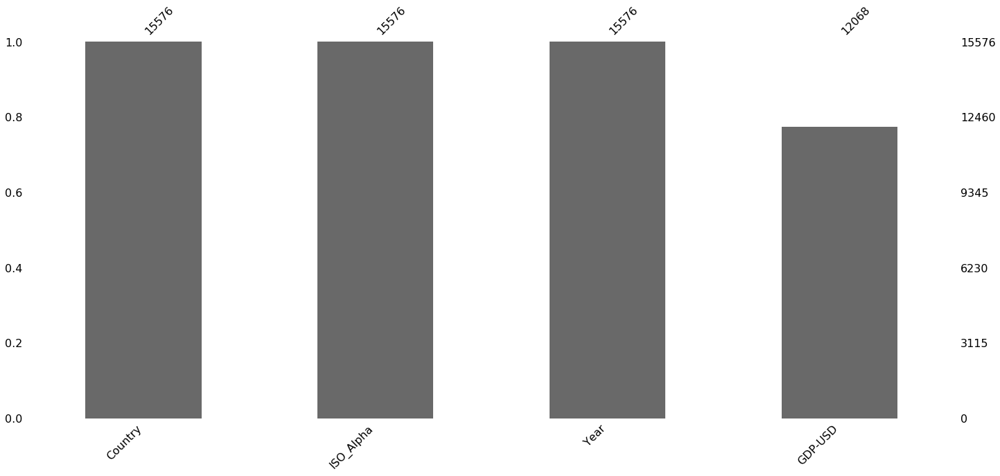

In [69]:
mno.bar(wb_gdp_df5)

### World Bank data dictionary updates

In [26]:
wb_gdp_meta_df1

,Country Code,Region,IncomeGroup,SpecialNotes,TableName,Unnamed: 5
0,ABW,Latin America & Caribbean,High income,NaN,Aruba,NaN
1,AFG,South Asia,Low income,NaN,Afghanistan,NaN
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola,NaN
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania,NaN
4,AND,Europe & Central Asia,High income,NaN,Andorra,NaN
5,ARB,NaN,NaN,Arab World aggregate. Arab World is composed of members of the League of Arab States.,Arab World,NaN
6,ARE,Middle East & North Africa,High income,NaN,United Arab Emirates,NaN
7,ARG,Latin America & Caribbean,Upper middle income,NaN,Argentina,NaN
8,ARM,Europe & Central Asia,Upper middle income,NaN,Armenia,NaN
9,ASM,East Asia & Pacific,Upper middle income,NaN,American Samoa,NaN


Let's rename some columns in the WB dataframe above in preparation for dataframe merge.

In [27]:
wb_gdp_meta_df2 = wb_gdp_meta_df1.rename(columns={'TableName': 'Country', 'Country Code': 'ISO_Alpha'})

In [28]:
wb_gdp_meta_df3 = wb_gdp_meta_df2.drop(['Unnamed: 5'], axis=1)

In [29]:
wb_gdp_meta_df3.head()

,ISO_Alpha,Region,IncomeGroup,SpecialNotes,Country
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra


### Check linkage column, `ISO_Alpha`, before Merge #1

Because we are going to merge WB data and metadata on the `ISO_Alpha` column, we have to check if they all match. 

In [30]:
wb_gdp_iso3 = wb_gdp_df5.ISO_Alpha.unique()
wb_gdp_country = wb_gdp_df5.Country.unique()

wb_gdp_c1 = pd.DataFrame({'ISO_Alpha':wb_gdp_iso3,'Country':wb_gdp_country})

wb_gdp_c1

,ISO_Alpha,Country
0,ABW,Aruba
1,AFG,Afghanistan
2,AGO,Angola
3,ALB,Albania
4,AND,Andorra
5,ARB,Arab World
6,ARE,United Arab Emirates
7,ARG,Argentina
8,ARM,Armenia
9,ASM,American Samoa


In [31]:
wb_gdp_meta_iso3 = wb_gdp_meta_df3.ISO_Alpha.unique()
wb_gdp_meta_country = wb_gdp_meta_df3.Country.unique()

wb_gdp_c2 = pd.DataFrame({'ISO_Alpha':wb_gdp_meta_iso3,'Country':wb_gdp_meta_country})

wb_gdp_c2

,ISO_Alpha,Country
0,ABW,Aruba
1,AFG,Afghanistan
2,AGO,Angola
3,ALB,Albania
4,AND,Andorra
5,ARB,Arab World
6,ARE,United Arab Emirates
7,ARG,Argentina
8,ARM,Armenia
9,ASM,American Samoa


Using `numpy` let'e check which `Country` names don't match.

In [32]:
import numpy as np

wb_nonmatch = np.setdiff1d(wb_gdp_iso3, wb_gdp_meta_iso3)

wb_nonmatch

array(['INX'], dtype=object)

The value `INX` does not represent a country.

### Merge #1: Merge WB data and metadata dataframes

In [38]:
merged_df1 = pd.merge(wb_gdp_meta_df3, wb_gdp_df5, on=['ISO_Alpha'], how='inner')

In [39]:
merged_df2 = merged_df1.rename(columns={'Country_x': 'Country'})

In [40]:
merged_df2

,ISO_Alpha,Region,IncomeGroup,SpecialNotes,Country,Country_y,Year,GDP-USD
0,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1960,NaN
1,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1961,NaN
2,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1962,NaN
3,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1963,NaN
4,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1964,NaN
5,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1965,NaN
6,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1966,NaN
7,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1967,NaN
8,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1968,NaN
9,ABW,Latin America & Caribbean,High income,NaN,Aruba,Aruba,1969,NaN


### Prepare for second merge between TB data and the merged WB data

In [41]:
tb_df1.head()

,country,iso2,iso3,iso_numeric,g_whoregion,year,e_pop_num,e_inc_100k,e_inc_100k_lo,e_inc_100k_hi,e_inc_num,e_inc_num_lo,e_inc_num_hi,e_tbhiv_prct,e_tbhiv_prct_lo,e_tbhiv_prct_hi,e_inc_tbhiv_100k,e_inc_tbhiv_100k_lo,e_inc_tbhiv_100k_hi,e_inc_tbhiv_num,e_inc_tbhiv_num_lo,e_inc_tbhiv_num_hi,e_mort_exc_tbhiv_100k,e_mort_exc_tbhiv_100k_lo,e_mort_exc_tbhiv_100k_hi,e_mort_exc_tbhiv_num,e_mort_exc_tbhiv_num_lo,e_mort_exc_tbhiv_num_hi,e_mort_tbhiv_100k,e_mort_tbhiv_100k_lo,e_mort_tbhiv_100k_hi,e_mort_tbhiv_num,e_mort_tbhiv_num_lo,e_mort_tbhiv_num_hi,e_mort_100k,e_mort_100k_lo,e_mort_100k_hi,e_mort_num,e_mort_num_lo,e_mort_num_hi,cfr,cfr_lo,cfr_hi,c_newinc_100k,c_cdr,c_cdr_lo,c_cdr_hi
0,Afghanistan,AF,AFG,4,EMR,2000,20093756,190.0,123.0,271.0,38000,25000,54000,0.36,0.12,0.72,0.68,0.20,1.50,140.0,40.0,290.0,67.0,39.0,103.0,14000,7800.0,21000.0,0.15,0.00,0.77,31,0,160,67.0,39.0,104.0,14000,7800,21000,NaN,NaN,NaN,35.0,19.0,13.0,29.0
1,Afghanistan,AF,AFG,4,EMR,2001,20966463,189.0,123.0,271.0,40000,26000,57000,0.30,0.10,0.61,0.57,0.16,1.20,120.0,34.0,260.0,62.0,36.0,95.0,13000,7500.0,20000.0,0.17,0.00,0.62,35,1,130,62.0,36.0,95.0,13000,7500,20000,NaN,NaN,NaN,48.0,26.0,18.0,39.0
2,Afghanistan,AF,AFG,4,EMR,2002,21979923,189.0,122.0,270.0,42000,27000,59000,0.26,0.09,0.52,0.49,0.15,1.00,110.0,32.0,230.0,56.0,33.0,86.0,12000,7200.0,19000.0,0.27,0.08,0.58,60,17,130,56.0,33.0,86.0,12000,7200,19000,NaN,NaN,NaN,63.0,33.0,23.0,51.0
3,Afghanistan,AF,AFG,4,EMR,2003,23064851,189.0,122.0,270.0,44000,28000,62000,0.23,0.09,0.45,0.44,0.14,0.92,100.0,31.0,210.0,57.0,33.0,87.0,13000,7700.0,20000.0,0.25,0.07,0.52,57,17,120,57.0,33.0,88.0,13000,7700,20000,NaN,NaN,NaN,60.0,32.0,22.0,49.0
4,Afghanistan,AF,AFG,4,EMR,2004,24118979,189.0,122.0,270.0,46000,29000,65000,0.22,0.08,0.42,0.41,0.13,0.85,100.0,32.0,210.0,51.0,30.0,77.0,12000,7100.0,19000.0,0.21,0.07,0.43,50,16,100,51.0,30.0,77.0,12000,7200,19000,NaN,NaN,NaN,76.0,40.0,28.0,62.0


In [42]:
tb_df2 = tb_df1.rename(columns={'country': 'Country', 'iso3': 'ISO_Alpha', 'year': 'Year'})

In [43]:
tb_df2

,Country,iso2,ISO_Alpha,iso_numeric,g_whoregion,Year,e_pop_num,e_inc_100k,e_inc_100k_lo,e_inc_100k_hi,e_inc_num,e_inc_num_lo,e_inc_num_hi,e_tbhiv_prct,e_tbhiv_prct_lo,e_tbhiv_prct_hi,e_inc_tbhiv_100k,e_inc_tbhiv_100k_lo,e_inc_tbhiv_100k_hi,e_inc_tbhiv_num,e_inc_tbhiv_num_lo,e_inc_tbhiv_num_hi,e_mort_exc_tbhiv_100k,e_mort_exc_tbhiv_100k_lo,e_mort_exc_tbhiv_100k_hi,e_mort_exc_tbhiv_num,e_mort_exc_tbhiv_num_lo,e_mort_exc_tbhiv_num_hi,e_mort_tbhiv_100k,e_mort_tbhiv_100k_lo,e_mort_tbhiv_100k_hi,e_mort_tbhiv_num,e_mort_tbhiv_num_lo,e_mort_tbhiv_num_hi,e_mort_100k,e_mort_100k_lo,e_mort_100k_hi,e_mort_num,e_mort_num_lo,e_mort_num_hi,cfr,cfr_lo,cfr_hi,c_newinc_100k,c_cdr,c_cdr_lo,c_cdr_hi
0,Afghanistan,AF,AFG,4,EMR,2000,20093756,190.00,123.00,271.00,38000,25000,54000,0.36,0.12,0.72,0.68,0.20,1.50,140.0,40.0,290.0,67.00,39.00,103.00,14000,7800.0,21000.0,0.15,0.00,0.77,31,0,160,67.00,39.00,104.00,14000,7800,21000,NaN,NaN,NaN,35.00,19.0,13.0,29.0
1,Afghanistan,AF,AFG,4,EMR,2001,20966463,189.00,123.00,271.00,40000,26000,57000,0.30,0.10,0.61,0.57,0.16,1.20,120.0,34.0,260.0,62.00,36.00,95.00,13000,7500.0,20000.0,0.17,0.00,0.62,35,1,130,62.00,36.00,95.00,13000,7500,20000,NaN,NaN,NaN,48.00,26.0,18.0,39.0
2,Afghanistan,AF,AFG,4,EMR,2002,21979923,189.00,122.00,270.00,42000,27000,59000,0.26,0.09,0.52,0.49,0.15,1.00,110.0,32.0,230.0,56.00,33.00,86.00,12000,7200.0,19000.0,0.27,0.08,0.58,60,17,130,56.00,33.00,86.00,12000,7200,19000,NaN,NaN,NaN,63.00,33.0,23.0,51.0
3,Afghanistan,AF,AFG,4,EMR,2003,23064851,189.00,122.00,270.00,44000,28000,62000,0.23,0.09,0.45,0.44,0.14,0.92,100.0,31.0,210.0,57.00,33.00,87.00,13000,7700.0,20000.0,0.25,0.07,0.52,57,17,120,57.00,33.00,88.00,13000,7700,20000,NaN,NaN,NaN,60.00,32.0,22.0,49.0
4,Afghanistan,AF,AFG,4,EMR,2004,24118979,189.00,122.00,270.00,46000,29000,65000,0.22,0.08,0.42,0.41,0.13,0.85,100.0,32.0,210.0,51.00,30.00,77.00,12000,7100.0,19000.0,0.21,0.07,0.43,50,16,100,51.00,30.00,77.00,12000,7200,19000,NaN,NaN,NaN,76.00,40.0,28.0,62.0
5,Afghanistan,AF,AFG,4,EMR,2005,25070798,189.00,122.00,270.00,47000,31000,68000,0.22,0.09,0.42,0.42,0.14,0.85,100.0,34.0,210.0,46.00,27.00,70.00,12000,6800.0,18000.0,0.19,0.06,0.39,48,16,99,46.00,27.00,71.00,12000,6900,18000,NaN,NaN,NaN,87.00,46.0,32.0,71.0
6,Afghanistan,AF,AFG,4,EMR,2006,25893450,189.00,122.00,270.00,49000,32000,70000,0.22,0.08,0.43,0.42,0.13,0.87,110.0,35.0,230.0,42.00,25.00,63.00,11000,6400.0,16000.0,0.18,0.06,0.37,46,15,95,42.00,25.00,64.00,11000,6400,16000,NaN,NaN,NaN,98.00,52.0,36.0,80.0
7,Afghanistan,AF,AFG,4,EMR,2007,26616792,189.00,122.00,270.00,50000,33000,72000,0.23,0.09,0.44,0.43,0.14,0.89,120.0,37.0,240.0,38.00,23.00,58.00,10000,6000.0,15000.0,0.17,0.05,0.34,45,14,91,38.00,23.00,58.00,10000,6000,15000,NaN,NaN,NaN,108.00,57.0,40.0,88.0
8,Afghanistan,AF,AFG,4,EMR,2008,27294031,189.00,122.00,270.00,52000,33000,74000,0.23,0.08,0.46,0.44,0.13,0.93,120.0,37.0,250.0,40.00,24.00,60.00,11000,6400.0,16000.0,0.18,0.05,0.37,48,15,100,40.00,24.00,60.00,11000,6500,17000,NaN,NaN,NaN,104.00,55.0,38.0,85.0
9,Afghanistan,AF,AFG,4,EMR,2009,28004331,189.00,123.00,270.00,53000,34000,76000,0.24,0.08,0.47,0.45,0.14,0.95,130.0,38.0,270.0,44.00,26.00,67.00,12000,7200.0,19000.0,0.20,0.06,0.42,55,16,120,44.00,26.00,67.00,12000,7300,19000,NaN,NaN,NaN,93.00,49.0,35.0,76.0


In [44]:
tb_df2.head()

,Country,iso2,ISO_Alpha,iso_numeric,g_whoregion,Year,e_pop_num,e_inc_100k,e_inc_100k_lo,e_inc_100k_hi,e_inc_num,e_inc_num_lo,e_inc_num_hi,e_tbhiv_prct,e_tbhiv_prct_lo,e_tbhiv_prct_hi,e_inc_tbhiv_100k,e_inc_tbhiv_100k_lo,e_inc_tbhiv_100k_hi,e_inc_tbhiv_num,e_inc_tbhiv_num_lo,e_inc_tbhiv_num_hi,e_mort_exc_tbhiv_100k,e_mort_exc_tbhiv_100k_lo,e_mort_exc_tbhiv_100k_hi,e_mort_exc_tbhiv_num,e_mort_exc_tbhiv_num_lo,e_mort_exc_tbhiv_num_hi,e_mort_tbhiv_100k,e_mort_tbhiv_100k_lo,e_mort_tbhiv_100k_hi,e_mort_tbhiv_num,e_mort_tbhiv_num_lo,e_mort_tbhiv_num_hi,e_mort_100k,e_mort_100k_lo,e_mort_100k_hi,e_mort_num,e_mort_num_lo,e_mort_num_hi,cfr,cfr_lo,cfr_hi,c_newinc_100k,c_cdr,c_cdr_lo,c_cdr_hi
0,Afghanistan,AF,AFG,4,EMR,2000,20093756,190.0,123.0,271.0,38000,25000,54000,0.36,0.12,0.72,0.68,0.20,1.50,140.0,40.0,290.0,67.0,39.0,103.0,14000,7800.0,21000.0,0.15,0.00,0.77,31,0,160,67.0,39.0,104.0,14000,7800,21000,NaN,NaN,NaN,35.0,19.0,13.0,29.0
1,Afghanistan,AF,AFG,4,EMR,2001,20966463,189.0,123.0,271.0,40000,26000,57000,0.30,0.10,0.61,0.57,0.16,1.20,120.0,34.0,260.0,62.0,36.0,95.0,13000,7500.0,20000.0,0.17,0.00,0.62,35,1,130,62.0,36.0,95.0,13000,7500,20000,NaN,NaN,NaN,48.0,26.0,18.0,39.0
2,Afghanistan,AF,AFG,4,EMR,2002,21979923,189.0,122.0,270.0,42000,27000,59000,0.26,0.09,0.52,0.49,0.15,1.00,110.0,32.0,230.0,56.0,33.0,86.0,12000,7200.0,19000.0,0.27,0.08,0.58,60,17,130,56.0,33.0,86.0,12000,7200,19000,NaN,NaN,NaN,63.0,33.0,23.0,51.0
3,Afghanistan,AF,AFG,4,EMR,2003,23064851,189.0,122.0,270.0,44000,28000,62000,0.23,0.09,0.45,0.44,0.14,0.92,100.0,31.0,210.0,57.0,33.0,87.0,13000,7700.0,20000.0,0.25,0.07,0.52,57,17,120,57.0,33.0,88.0,13000,7700,20000,NaN,NaN,NaN,60.0,32.0,22.0,49.0
4,Afghanistan,AF,AFG,4,EMR,2004,24118979,189.0,122.0,270.0,46000,29000,65000,0.22,0.08,0.42,0.41,0.13,0.85,100.0,32.0,210.0,51.0,30.0,77.0,12000,7100.0,19000.0,0.21,0.07,0.43,50,16,100,51.0,30.0,77.0,12000,7200,19000,NaN,NaN,NaN,76.0,40.0,28.0,62.0


In [45]:
tb_nonmatch = np.setdiff1d(tb_df2.ISO_Alpha.unique(), merged_df2.ISO_Alpha.unique())

tb_nonmatch

array(['AIA', 'ANT', 'BES', 'COK', 'MSR', 'NIU', 'SCG', 'TKL', 'WLF'],
      dtype=object)

In [46]:
for iso3 in tb_nonmatch:
    print(iso3, tb_df2.query("ISO_Alpha=='"+iso3+"'")['Country'].unique())

AIA ['Anguilla']
ANT ['Netherlands Antilles']
BES ['Bonaire, Saint Eustatius and Saba']
COK ['Cook Islands']
MSR ['Montserrat']
NIU ['Niue']
SCG ['Serbia & Montenegro']
TKL ['Tokelau']
WLF ['Wallis and Futuna Islands']


### Merge #2: Merge TB data with WB data

In [47]:
merged_df3 = pd.merge(merged_df2, tb_df2, on=['ISO_Alpha', 'Year'], how='inner')

In [48]:
merged_df4 = merged_df3.rename(columns={'Country_x': 'Country'})

In [49]:
merged_df4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3719 entries, 0 to 3718
Data columns (total 53 columns):
ISO_Alpha                   3719 non-null object
Region                      3719 non-null object
IncomeGroup                 3719 non-null object
SpecialNotes                1034 non-null object
Country                     3719 non-null object
Country_y                   3719 non-null object
Year                        3719 non-null int64
GDP-USD                     3566 non-null float64
Country_y                   3719 non-null object
iso2                        3701 non-null object
iso_numeric                 3719 non-null int64
g_whoregion                 3719 non-null object
e_pop_num                   3719 non-null int64
e_inc_100k                  3719 non-null float64
e_inc_100k_lo               3719 non-null float64
e_inc_100k_hi               3719 non-null float64
e_inc_num                   3719 non-null int64
e_inc_num_lo                3719 non-null int64
e_inc_num_hi

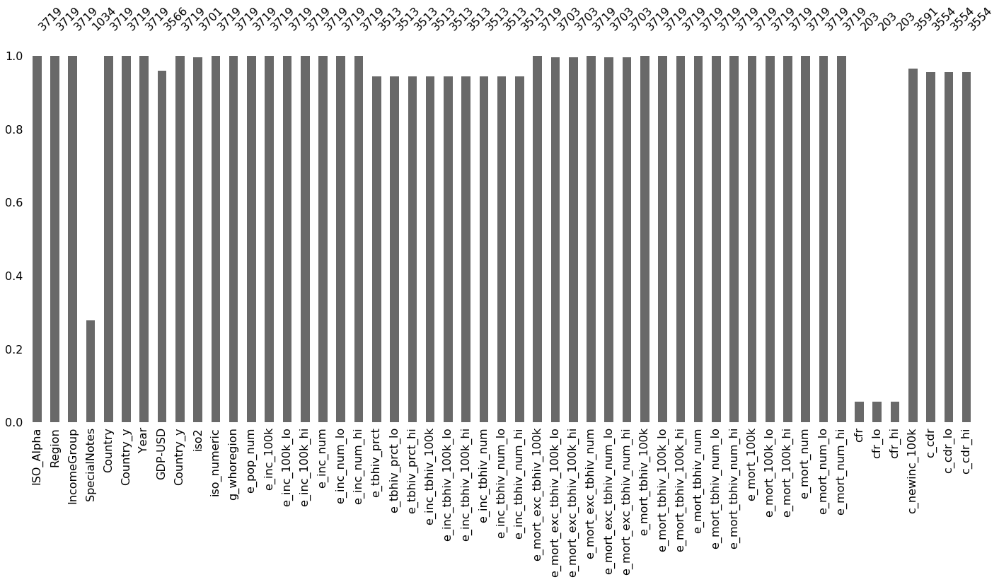

In [68]:
mno.bar(merged_df4)

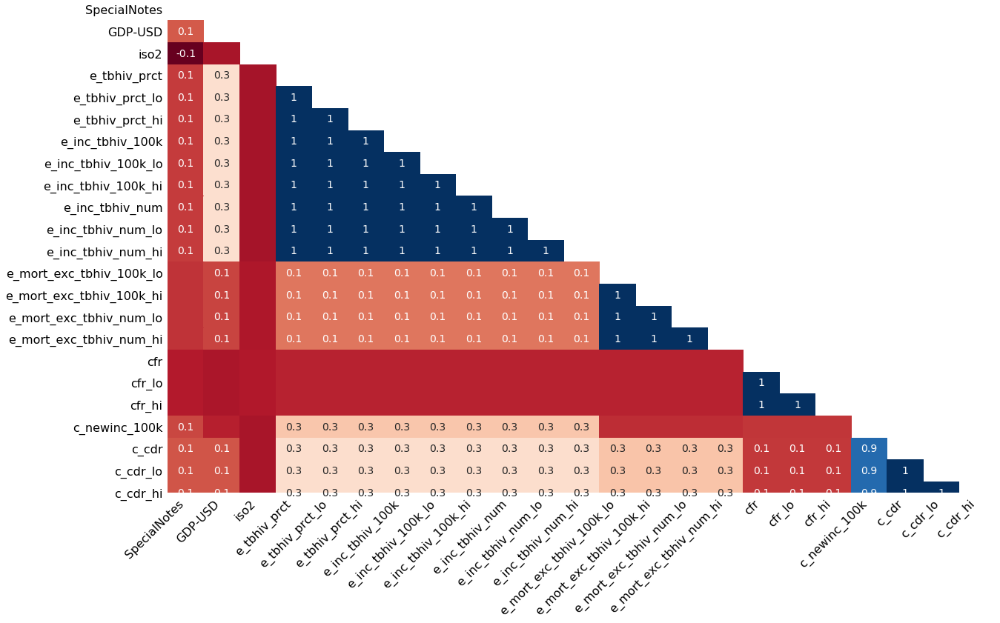

In [71]:
mno.heatmap(merged_df4)

### 2017 subset of second-merge dataframe

In [50]:
is_2017 = merged_df4['Year'] == 2017

In [51]:
merged_df4_2017 = merged_df4[is_2017]

In [52]:
merged_df4_2017.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 209 entries, 17 to 3718
Data columns (total 53 columns):
ISO_Alpha                   209 non-null object
Region                      209 non-null object
IncomeGroup                 209 non-null object
SpecialNotes                58 non-null object
Country                     209 non-null object
Country_y                   209 non-null object
Year                        209 non-null int64
GDP-USD                     198 non-null float64
Country_y                   209 non-null object
iso2                        208 non-null object
iso_numeric                 209 non-null int64
g_whoregion                 209 non-null object
e_pop_num                   209 non-null int64
e_inc_100k                  209 non-null float64
e_inc_100k_lo               209 non-null float64
e_inc_100k_hi               209 non-null float64
e_inc_num                   209 non-null int64
e_inc_num_lo                209 non-null int64
e_inc_num_hi                209

## STEP 4. Visualizations using Plotly Express

In [53]:
px.scatter(merged_df4_2017, x="GDP-USD", log_x=True, log_y=True, y="e_mort_num", \
           hover_name="Country")

In [54]:
px.scatter(merged_df4_2017, x="GDP-USD", log_x=True, log_y=True, y="e_mort_tbhiv_100k", hover_name="Country")

In [55]:
px.scatter(merged_df4_2017, x="GDP-USD", y="e_mort_num", \
           color="Region", size="e_pop_num", size_max=60, hover_name="Country")

In [61]:
px.scatter(merged_df4, x="GDP-USD", y="e_mort_num", animation_frame="Year", \
           animation_group="Country", width=1000,\
           size="e_pop_num", color="Region", hover_name="Country", \
           log_x=True, log_y=True, size_max=80, \
           range_x=[100,120000], range_y=[1,3000000])

In [53]:
px.choropleth(merged_df4, locations="ISO_Alpha", color="e_mort_num", hover_name="Country", animation_frame="Year",
             color_continuous_scale=px.colors.sequential.OrRd)